In [2]:
import os
import json
import torch
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.path import Path
from torchvision.transforms import v2 as T

from transformers import DetrImageProcessor, DetrForObjectDetection
import numpy as np


In [2]:
class CustomDataset:
    def __init__(self, folder_path, transforms=None):
        self.folder_path = folder_path
        self.transforms = transforms
        self.data_pairs = self._load_data_pairs()
        self.image_processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")

    def _load_data_pairs(self):
        image_files = []
        json_files = {}
        data_pairs = []

        # 폴더를 재귀적으로 검색하여 이미지 파일과 JSON 파일 목록을 생성
        for root, _, files in os.walk(self.folder_path):
            for file in files:
                if file.endswith((".jpg", ".jpeg", ".png")):
                    image_files.append(os.path.join(root, file))
                elif file.endswith(".json"):
                    json_files[os.path.splitext(file)[0]] = os.path.join(root, file)

        # 진행률 표시줄 추가
        for image_file_path in tqdm(image_files, desc="Matching image and JSON files"):
            # 이미지 파일 이름에서 확장자를 제외한 부분 가져오기
            image_name = os.path.splitext(os.path.basename(image_file_path))[0]
        
            # 해당 이미지 파일과 매칭되는 JSON 파일 찾기
            if image_name in json_files:
                json_file_path = json_files[image_name]
                data_pairs.append((image_file_path, json_file_path))
            else:
                print(f"JSON file not found for image: {image_file_path}")
        
        return data_pairs

    def create_detr_target(self, json_data):
        annotations = json_data['annotations']
        categories = {cat['id']: cat['name'] for cat in json_data['categories']}
        
        # 한글에서 영어로 라벨을 매핑하는 딕셔너리
        label_mapping = {'화방': 0, '줄기': 1, '잎': 2, '열매': 3}  # 예시, 실제 매핑에 맞게 수정 필요

        height = 1960  # 로즈 테스트시 고정값 사용
        width = float(json_data['images'][0]['width'])

        target = {
            'boxes': [],
            'class_labels': [],
        }

        for ann in annotations:
            bbox = ann['bbox']  # 바운딩 박스 좌표
            obj_name = categories[ann['category_id']]  # 객체 이름

            # 한글 카테고리 이름을 영어로 변환하여 매핑된 정수 레이블 얻기
            label = label_mapping.get(obj_name, -1)  # 없는 경우에 대한 처리

            if label == -1:
                # 처리할 수 없는 경우 스킵하거나 예외 처리 필요
                pass

            # 바운딩 박스 좌표 변환 및 정규화
            x_min = bbox[1] / width
            y_min = (height - (bbox[0] + bbox[2])) / height
            box_width = bbox[3] / width
            box_height = bbox[2] / height

            # target 딕셔너리에 정보 추가
            target = {
                'boxes': [[x_min, y_min, box_width, box_height]],  # 바운딩 박스 좌표
                'class_labels': [label],  # 객체의 정수 레이블
            }

            # 리스트를 텐서로 변환
            target['boxes'] = torch.tensor(target['boxes'], dtype=torch.float32)
            target['class_labels'] = torch.tensor(target['class_labels'], dtype=torch.int64)  # 클래스 레이블을 정수로 변환

            return target

    def preprocess_image(self, image):
        img = self.image_processor(image, return_tensors="pt")
        images = img['pixel_values'].clone().detach().to(torch.float32)
        images = images.permute(0, 1, 3, 2)  # (batch_size, channels, height, width) 순으로 변환
        return images
        
    def __getitem__(self, index):
        img_path, json_path = self.data_pairs[index]

        with open(json_path, 'r') as f:
            json_data = json.load(f)

        img = Image.open(img_path).convert("RGB")

        images = self.preprocess_image(img)  # (1, channels, height, width) 형태로 반환
        images = images.squeeze(0)  # 첫 번째 차원을 제거하여 (channels, height, width) 형태로 변환

       
        target = self.create_detr_target(json_data)

        return images, target

    def __len__(self):
        return len(self.data_pairs)

In [3]:
folder_path = "./Dataset"
# 데이터셋 객체 생성
dataset1 = CustomDataset(folder_path)

# 데이터셋의 첫 번째 샘플에 대한 타겟 정보 확인
sample_img, sample_target = dataset1[10]
# 타겟의 모양과 유형을 출
print("target:", sample_target)
print("shape of target:", sample_target['boxes'].shape)

print("img:", sample_img)
print("Type of img:", type(sample_img))
print("shape of img:", sample_img.shape)

print(sample_target["class_labels"])


Matching image and JSON files: 100%|██████████| 411/411 [00:00<00:00, 412603.86it/s]


target: {'boxes': tensor([[0.5133, 0.4207, 0.4696, 0.1077]]), 'class_labels': tensor([1])}
shape of target: torch.Size([1, 4])
img: tensor([[[ 2.2489,  2.2489,  2.2489,  ...,  0.9988,  0.9474,  0.9303],
         [ 2.2489,  2.2489,  2.2489,  ...,  1.2728,  1.2557,  1.2728],
         [ 2.2489,  2.2489,  2.2489,  ...,  1.4269,  1.4269,  1.4098],
         ...,
         [-1.4329, -1.4672, -1.5014,  ..., -0.5938, -0.5253, -0.5082],
         [-1.4329, -1.5014, -1.5185,  ..., -0.5938, -0.5424, -0.5938],
         [-1.3473, -1.4329, -1.3815,  ..., -0.6281, -0.5767, -0.5767]],

        [[ 2.4286,  2.4286,  2.4286,  ...,  1.2031,  1.1681,  1.1331],
         [ 2.4286,  2.4286,  2.4286,  ...,  1.4657,  1.4657,  1.4482],
         [ 2.4286,  2.4286,  2.4286,  ...,  1.6057,  1.6057,  1.5882],
         ...,
         [-0.7052, -0.7402, -0.7752,  ...,  0.0476,  0.1001,  0.1176],
         [-0.7052, -0.7752, -0.7927,  ...,  0.1001,  0.1176,  0.0651],
         [-0.6176, -0.7052, -0.6527,  ...,  0.1176,  0.11

In [4]:
# # DETR 모델에 입력하기 위한 준비
# inputs = {
#     'pixel_values': sample_img.unsqueeze(0),  # 배치 차원 추가
#     'labels': [sample_target]  # 타겟을 리스트로 감싸서 전달
# }

In [3]:
train_path = "./dataset/train"
val_path="./dataset/val"
test_path="./dataset/test/IMG"
save_weights = './output/weights'



In [6]:
print(os.path.exists(train_path))
print(os.path.exists(val_path))
print(os.path.exists(test_path))
print(os.path.exists(save_weights))

True
True
True
True


In [7]:
def collate_fn(batch):
    images = torch.stack([item[0] for item in batch])
    targets = [item[1] for item in batch]
    return images, targets

In [12]:
normalize = T.Compose([
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
])

transform_train = T.Compose([
    T.RandomResizedCrop(256),
    T.RandomHorizontalFlip(),
    normalize
])

transform_val = T.Compose([
    T.Resize(256),
    T.CenterCrop(256),
    normalize
])

# 데이터셋 객체 생성
dataset_train = CustomDataset(train_path, transforms=transform_train)
dataset_val = CustomDataset(val_path, transforms=transform_val)
# dataset_test = CustomDataset(test_path, transforms=normalize)  # 테스트 데이터는 정규화만 수행합니다.

# # Subset 생성
# indices = torch.randperm(len(dataset)).tolist()
# train_indices = indices[:-10]
# val_indices = indices[-10:]

# # Subset으로 학습, 검증 데이터셋 생성
# train_dataset = torch.utils.data.Subset(dataset, train_indices)
# val_dataset = torch.utils.data.Subset(dataset_val, val_indices)

# 데이터로더 정의
train_loader = torch.utils.data.DataLoader(
    dataset_train,
    shuffle=True,
     batch_size=2,
    collate_fn=collate_fn
)

val_loader = torch.utils.data.DataLoader(
    dataset_val,
    shuffle=False,
    batch_size=2,
    collate_fn=collate_fn
)

# test_loader = torch.utils.data.DataLoader(
#     dataset_test,
#     shuffle=False,

#     collate_fn=collate_fn
# )


c:\Users\User\anaconda3\envs\py3_11\Lib\site-packages\torchvision\transforms\v2\_deprecated.py:41: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(
Matching image and JSON files: 100%|██████████| 80/80 [00:00<?, ?it/s]


In [13]:

for batch in val_loader:
    images, targets = batch
    print("Images Shape:", images.shape)
    print("Targets:", targets)
    break

Images Shape: torch.Size([2, 3, 1333, 648])
Targets: [{'boxes': tensor([[0.3427, 0.2163, 0.2997, 0.6853]]), 'class_labels': tensor([0])}, {'boxes': tensor([[0.3046, 0.3111, 0.2928, 0.4801]]), 'class_labels': tensor([0])}]


In [14]:
import math
import sys
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from transformers import DetrImageProcessor
import detr.util.misc as utils

In [4]:
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50", revision="no_timm")
# 장치 설정 (GPU 사용 가능 여부 확인)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [16]:
import torch.nn.init as init

def initialize_weights(model):
    for m in model.modules():
        if isinstance(m, torch.nn.Conv2d):
            init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            if m.bias is not None:
                init.constant_(m.bias, 0)
        elif isinstance(m, torch.nn.BatchNorm2d):
            init.constant_(m.weight, 1)
            init.constant_(m.bias, 0)
        elif isinstance(m, torch.nn.Linear):
            init.xavier_normal_(m.weight)
            if m.bias is not None:
                init.constant_(m.bias, 0)


In [17]:
# 하이퍼파라미터 설정
num_epochs = 12
learning_rate = 0.0001
print_freq = 10

# 옵티마이저 설정
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=2, gamma=0.1)


model.to(device)

DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): ResNetBackbone(
          (embedder): ResNetEmbeddings(
            (embedder): ResNetConvLayer(
              (convolution): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
              (normalization): DetrFrozenBatchNorm2d()
              (activation): ReLU()
            )
            (pooler): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          )
          (encoder): ResNetEncoder(
            (stages): ModuleList(
              (0): ResNetStage(
                (layers): Sequential(
                  (0): ResNetBottleNeckLayer(
                    (shortcut): ResNetShortCut(
                      (convolution): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
                      (normalization): DetrFrozenBatchNorm2d()
                    )
                    (layer): Seq

In [18]:
import torch
from tqdm import tqdm
import time
import os

# 예상 총 소요 시간을 계산할 변수 초기화
total_training_time = 0.0

# 모델 훈련 반복문
best_loss = float('inf')  # 매우 큰 초기 손실값 설정
best_model_state = None

# 파일 경로 설정
train_loss_file = 'train_loss.txt'
val_loss_file = 'val_loss.txt'

# 파일이 이미 존재하면 기존 내용 삭제
if os.path.exists(train_loss_file):
    os.remove(train_loss_file)
if os.path.exists(val_loss_file):
    os.remove(val_loss_file)

for epoch in range(num_epochs):
    model.train()
    total_loss = 0.0
    start_time = time.time()  # 에폭 시작 시간 측정

    # tqdm으로 감싼 DataLoader 사용
    for images, targets in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}", leave=False):
        images = images.to(device)
        targets = [{'boxes': t['boxes'].to(device), 'class_labels': t['class_labels'].to(device)} for t in targets]

        # 모델 호출 후 손실 계산
        outputs = model(images, labels=targets)
        loss_dict = outputs.loss_dict
        losses = sum(loss for loss in loss_dict.values())

        # 역전파 및 옵티마이저로 모델 업데이트
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()

    # 한 에폭 종료 후 평균 손실 계산 및 출력
    avg_loss = total_loss / len(train_loader)
    epoch_time = time.time() - start_time  # 에폭 소요 시간 계산
    print(f"에폭 {epoch+1}/{num_epochs}, 총 손실: {avg_loss:.4f}, 소요 시간: {epoch_time:.2f}초")

    # 훈련 손실을 파일에 기록
    with open(train_loss_file, 'a') as f:
        f.write(f"{avg_loss}\n")

    # 예상 총 소요 시간 업데이트
    total_training_time += epoch_time

    # 검증 데이터셋을 사용한 모델 평가
    model.eval()
    with torch.no_grad():
        val_loss = 0.0
        for images, targets in val_loader:
            images = images.to(device)
            targets = [{'boxes': t['boxes'].to(device), 'class_labels': t['class_labels'].to(device)} for t in targets]
            outputs = model(images, labels=targets)
            loss_dict = outputs.loss_dict
            losses = sum(loss for loss in loss_dict.values())
            val_loss += losses.item()
        val_loss /= len(val_loader)

    # 검증 손실을 파일에 기록
    with open(val_loss_file, 'a') as f:
        f.write(f"{val_loss}\n")

    # 손실 기준으로 모델 저장
    lr_scheduler.step(val_loss)
    if val_loss < best_loss:
        best_loss = val_loss
        best_model_state = model.state_dict()
        save_path = os.path.join(save_weights, 'detr_model.pth')
        torch.save(best_model_state, save_path)  # 모델 가중치 저장 경로 명시

    # 예시로 손실이 감소하지 않으면 조기 종료 조건으로 설정
    if val_loss > best_loss:
        print(f"조기 종료: 에폭 {epoch+1}, 최적 손실: {best_loss:.4f}")
        break
    torch.cuda.empty_cache()
# # 최종 학습 완료 후 저장된 최적 모델 불러오기
# if best_model_state is not None:
#     model.load_state_dict(best_model_state)

# 총 예상 소요 시간 출력
print(f"총 예상 소요 시간: {total_training_time:.2f}초")


에폭 1/12, 총 손실: 2.6741, 소요 시간: 67.73초


c:\Users\User\anaconda3\envs\py3_11\Lib\site-packages\torch\optim\lr_scheduler.py:156: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


에폭 2/12, 총 손실: 1.9180, 소요 시간: 64.83초


에폭 3/12, 총 손실: 2.4654, 소요 시간: 65.52초
조기 종료: 에폭 3, 최적 손실: 1.8881
총 예상 소요 시간: 198.07초


In [5]:
import random
CLASSES= ['background','buds','smep','leaf','fruit']
COLORS = [(random.random(), random.random(), random.random()) for _ in range(5)]

In [63]:
import torch
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms

# 추론을 위한 변환 정의
transform = transforms.Compose([
    transforms.Resize((800, 800)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 바운딩 박스 변환 함수 (center_x, center_y, height, width -> xmin, ymin, xmax, ymax)
def box_cxcywh_to_xyxy(x, size):
    img_w, img_h = size
    x_c, y_c, h, w = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    b = torch.stack(b, dim=1)
    b *= torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32).to(b.device)
    return b

# 결과 시각화 함수 정의
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = plt.cm.hsv(np.linspace(0, 1, len(boxes)))
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{cl}: {p[cl]:0.2f}' if cl < len(CLASSES) else 'unkown class'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# 추론 및 시각화 함수 정의
def inference_and_visualize(model, img_path):
    model.eval()  # 모델을 평가 모드로 설정
    img = Image.open(img_path).convert("RGB")
    
    # 이미지 변환 적용
    img_tensor = transform(img).unsqueeze(0).to(device)
    
    # 추론 수행
    with torch.no_grad():
        outputs = model(img_tensor)

    # 결과 처리
    probas = torch.nn.functional.softmax(outputs['logits'], -1)[:, :-1]  # softmax 적용
    boxes = box_cxcywh_to_xyxy(outputs['pred_boxes'][0], img.size)
    
    # 결과 시각화
    plot_results(img, probas[0], boxes)

# 저장된 최적 모델 상태 불러오기
best_model_path = os.path.join(save_weights, 'detr_model.pth')
if os.path.exists(best_model_path):
    model.load_state_dict(torch.load(best_model_path))
    model.to(device)
    print("저장된 모델을 불러왔습니다.")
else:
    print(best_model_path)


저장된 모델을 불러왔습니다.


In [64]:
import os


img_format = {'jpg', 'png', 'jpeg'}
paths = []

for root, dirs, files in os.walk(test_path):
    for file in files:
        if file.split(".")[-1] in img_format:
            paths.append(os.path.join(root, file))

print('Total number of test images:', len(paths))
print(test_path)

Total number of test images: 56
./dataset/test/IMG


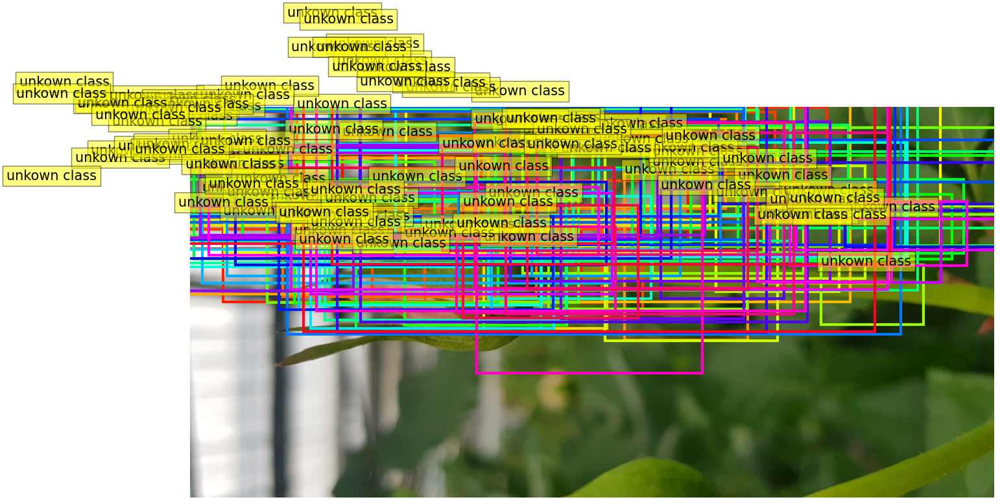

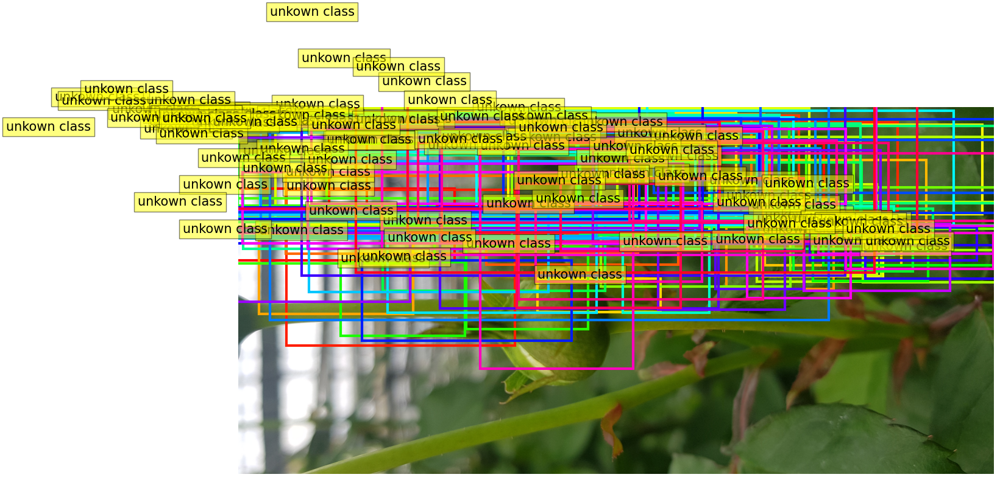

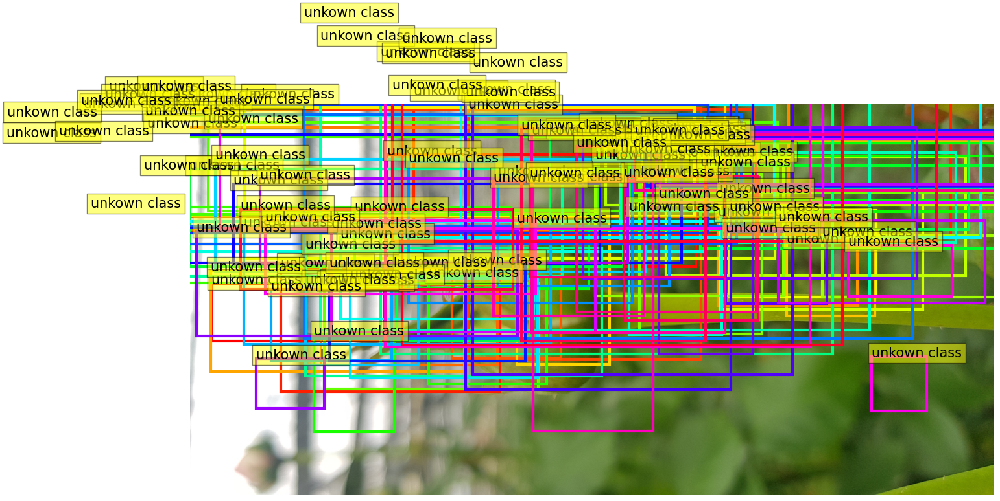

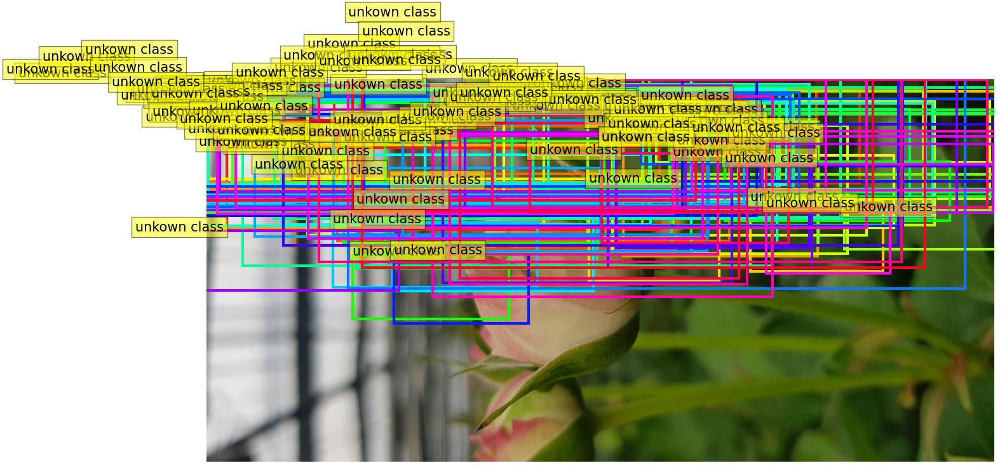

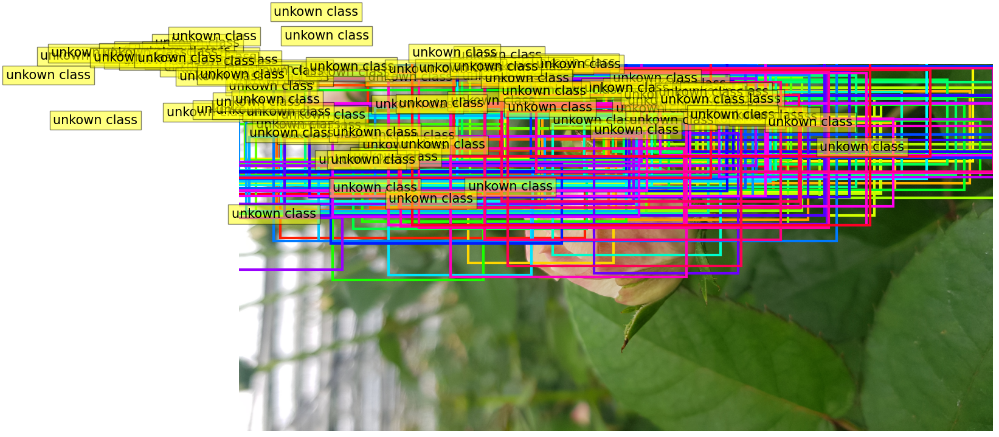

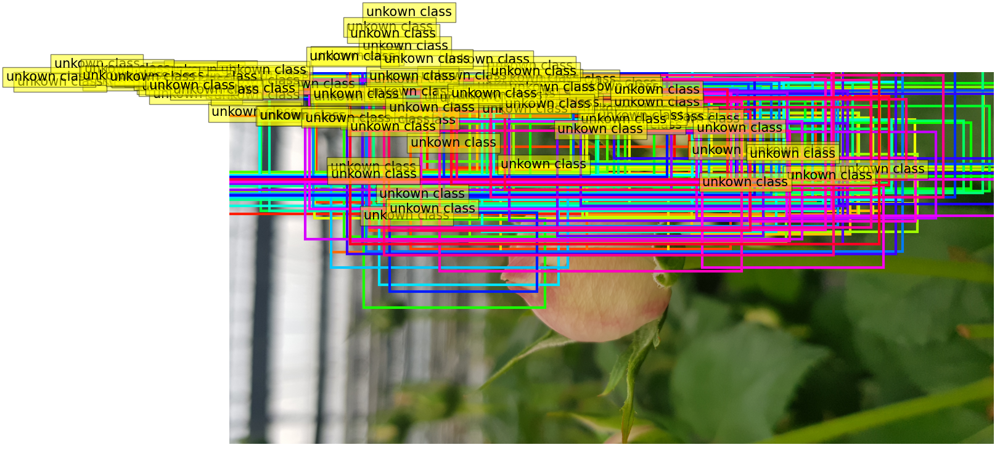

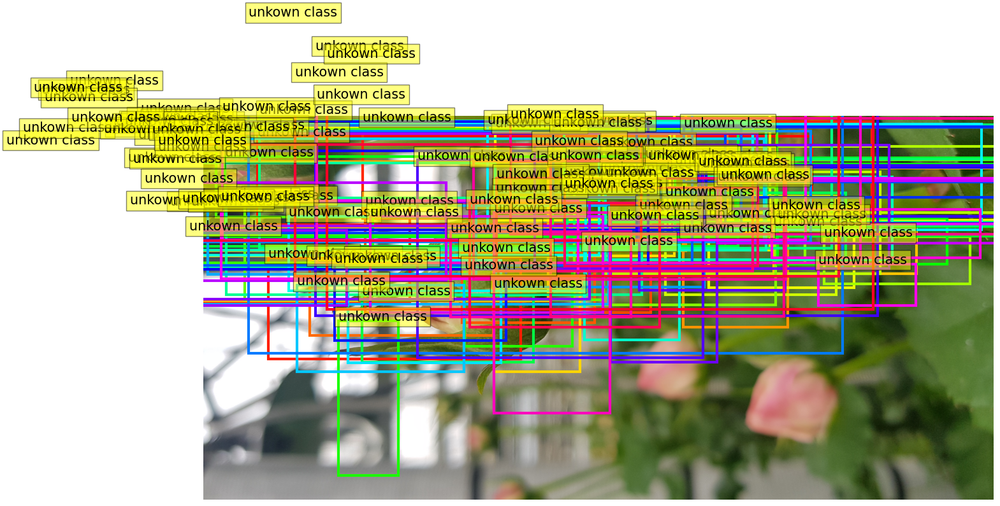

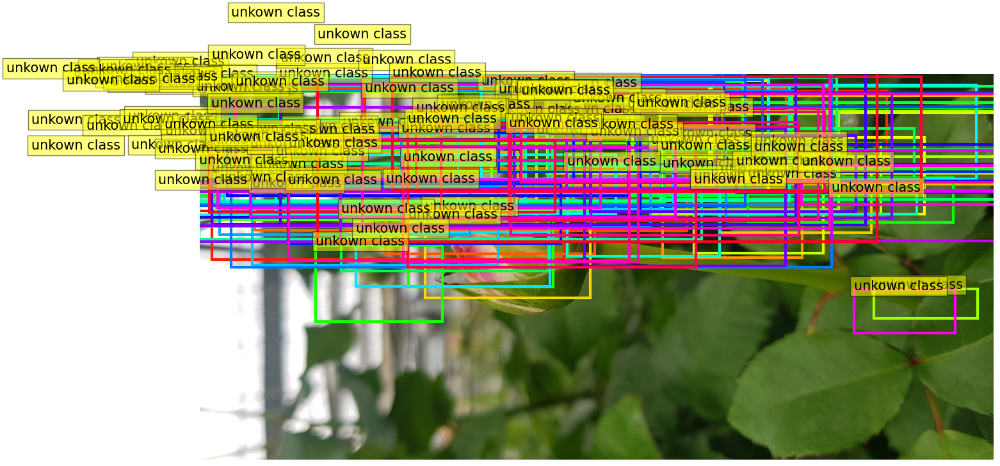

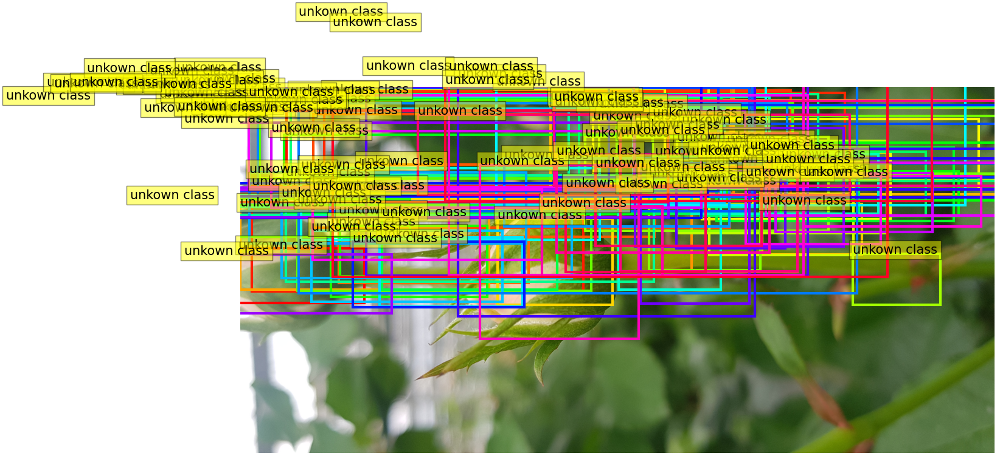

In [65]:
for i in paths[1:10]:
  inference_and_visualize(model,i)

In [56]:
import time
import math

transform = T.Compose([
    T.Resize((800, 800)),
    T.ToTensor(),
    T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32).to(b.device)
    return b

def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=3))
        cl = p.argmax()
        text = f'{CLASSES[cl]}: {p[cl]:0.2f}' if cl < len(CLASSES) else 'Unknown class'
        ax.text(xmin, ymin, text, fontsize=15,
                bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

def postprocess_img(img_path): 
  imgs = Image.open(img_path)

  # mean-std normalize the input image (batch-size: 1)
  img = transform(imgs).unsqueeze(0).to(device)

  # propagate through the model
  start = time.time()
  outputs = model(img)
  end = time.time()
  print(f'Prediction time per image: {math.ceil(end - start)}s ', )

  # keep only predictions with 0.7+ confidence
  probas = outputs['logits'].softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > 0.9

  # convert boxes from [0; 1] to image scales
  bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], imgs.size)
  
  plot_results(imgs, probas[keep], bboxes_scaled)


c:\Users\User\anaconda3\envs\py3_11\Lib\site-packages\torchvision\transforms\v2\_deprecated.py:41: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.
  warnings.warn(


In [57]:
import os


img_format = {'jpg', 'png', 'jpeg'}
paths = []

for root, dirs, files in os.walk(test_path):
    for file in files:
        if file.split(".")[-1] in img_format:
            paths.append(os.path.join(root, file))

print('Total number of test images:', len(paths))
print(test_path)

Total number of test images: 56
./dataset/test/IMG


Prediction time per image: 1s 


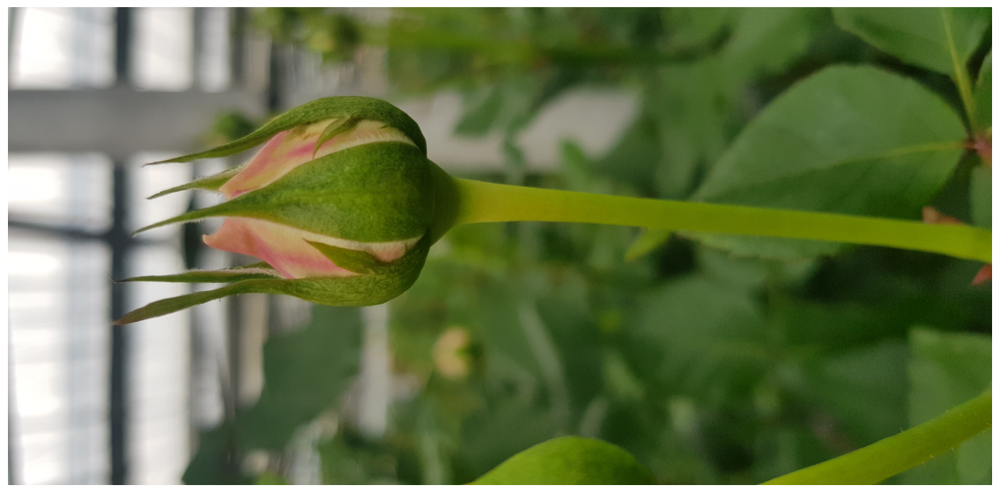

Prediction time per image: 1s 


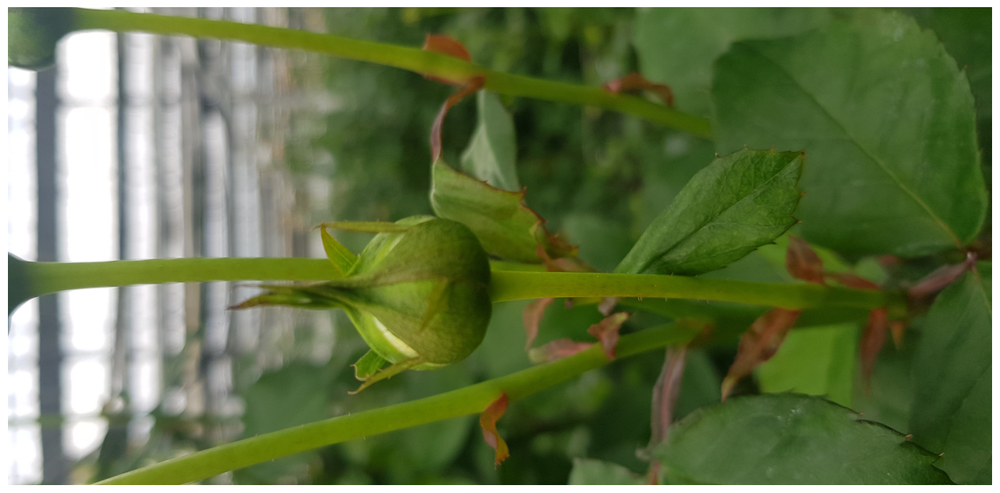

Prediction time per image: 1s 


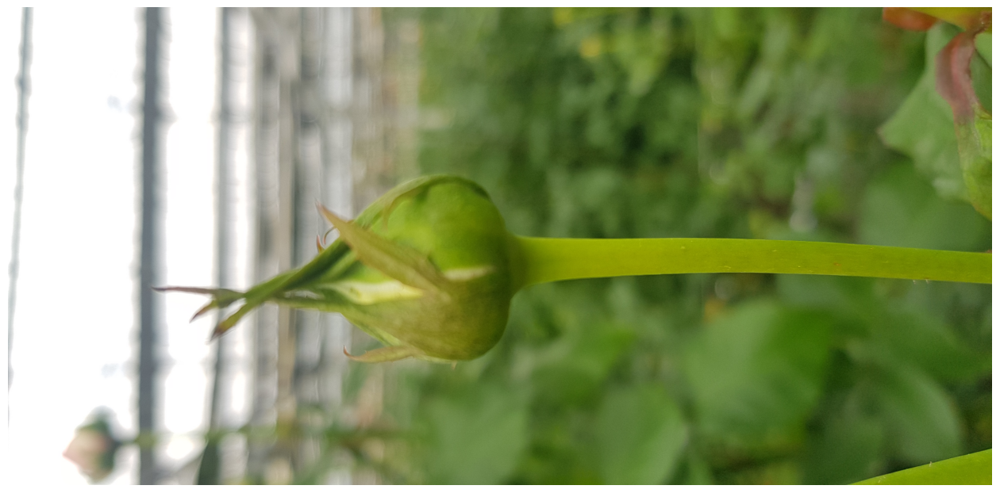

Prediction time per image: 1s 


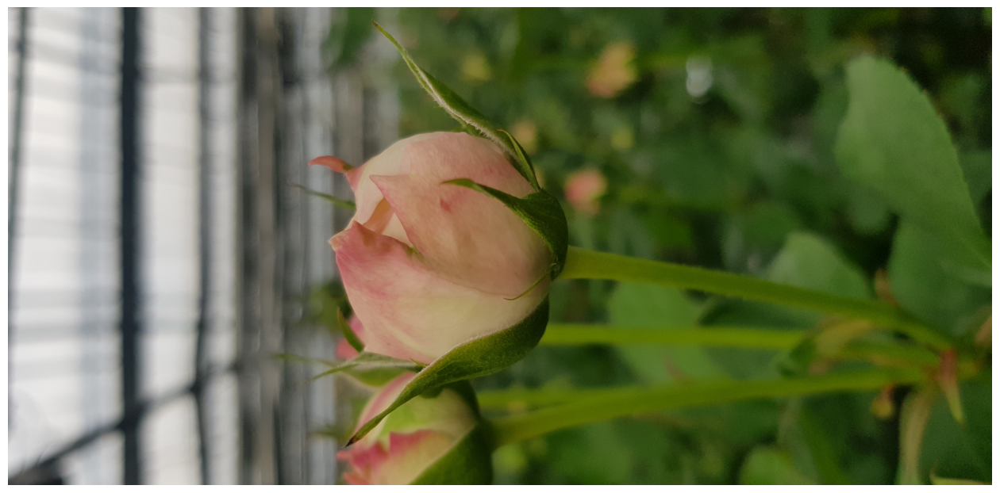

Prediction time per image: 1s 


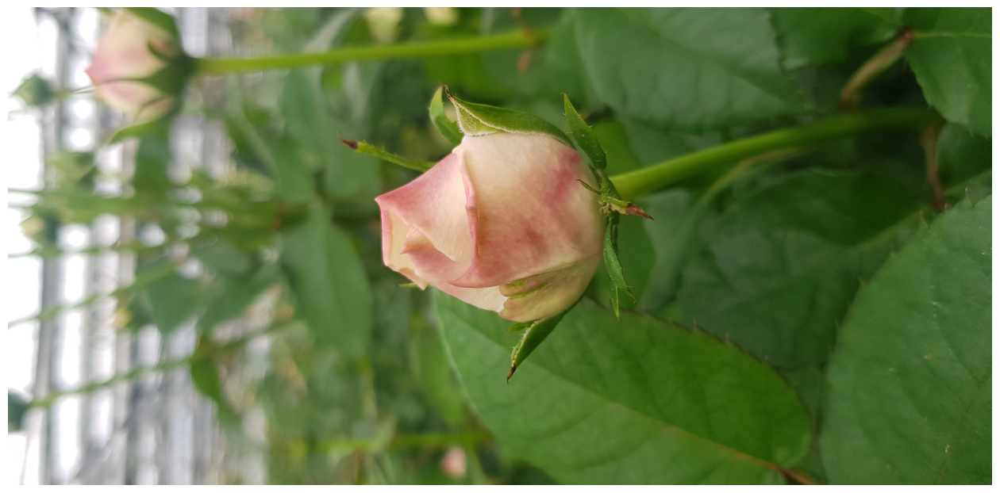

Prediction time per image: 1s 


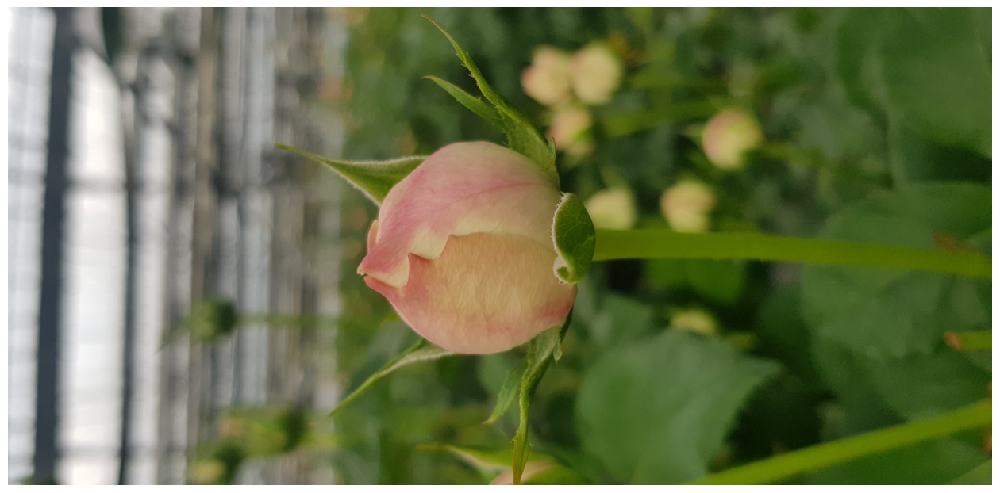

Prediction time per image: 1s 


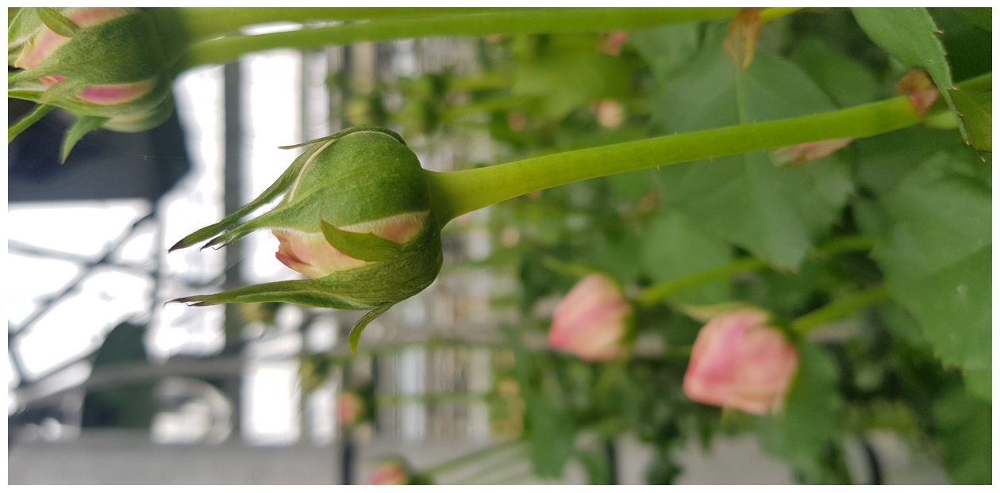

Prediction time per image: 1s 


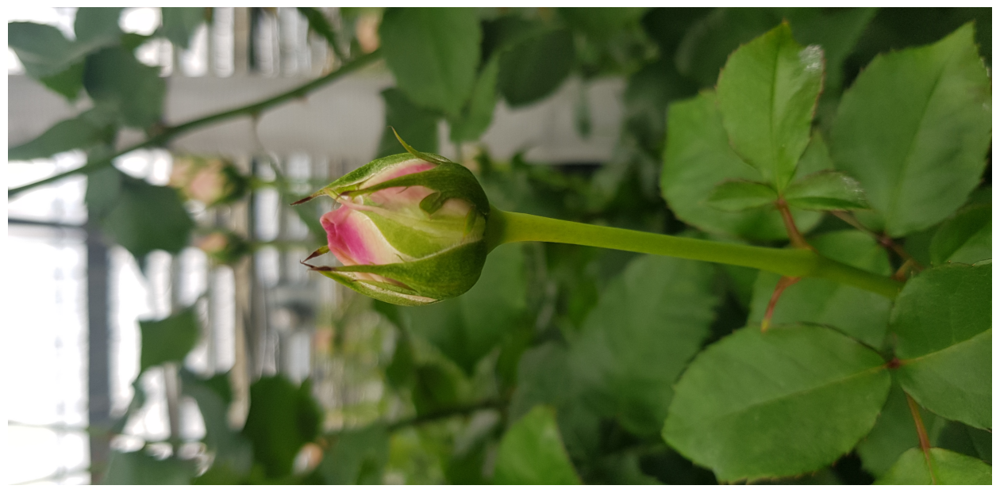

Prediction time per image: 1s 


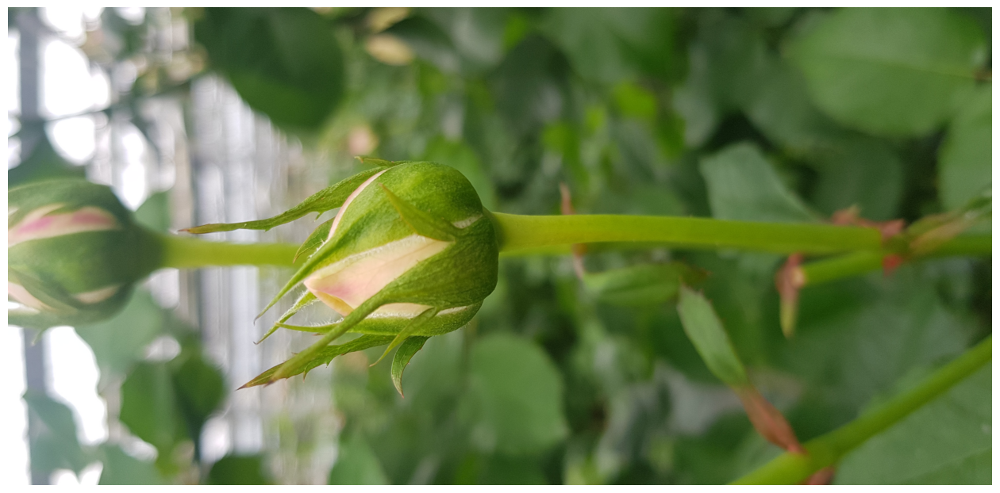

In [58]:

for i in paths[1:10]:
  postprocess_img(i)

In [104]:
model.eval()
model.to(device)
def inference_and_plot(img_path):
    # 이미지 불러오기
    img = Image.open(img_path).convert("RGB")
    
    # 이미지 정규화 및 GPU로 이동
    img_tensor = normalize(img).unsqueeze(0).to(device)

    # 추론 수행
    start = torch.cuda.Event(enable_timing=True)
    end = torch.cuda.Event(enable_timing=True)
    start.record()

    outputs = model(img_tensor)

    end.record()
    torch.cuda.synchronize()
    print(f'이미지당 예측 시간: {math.ceil(start.elapsed_time(end))}ms')

    # 0.7 이상의 신뢰도를 가진 예측 결과만 선택
    probas = outputs['pred_logits'].softmax(-1)[:, :-1]
    keep = probas.max(-1).values > 0.7

    # 박스를 이미지 크기로 변환 [0; 1]
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], img.size)

    # 시각화 함수 호출
    plot_results(img, probas[keep], bboxes_scaled)

# 시각화 함수 정의
def plot_results(pil_img, prob, boxes):
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = plt.cm.hsv(torch.linspace(0, 1, len(boxes)).tolist())
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=2))
        cl = p.argmax()
        ax.text(xmin, ymin, f'{cl}', fontsize=12, bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

# 추론 및 시각화 수행
def inference_and_visualize(test_path):
    test_images = list(Path(test_path).glob('*.jpg')) + list(Path(test_path).glob('*.jpeg')) + list(Path(test_path).glob('*.png'))
    for img_path in test_images:
        inference_and_plot(img_path)

# 실행
inference_and_visualize(test_path)

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.82 GiB. GPU 0 has a total capacity of 12.00 GiB of which 0 bytes is free. Of the allocated memory 8.01 GiB is allocated by PyTorch, and 2.48 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [37]:
# 예측 후 시각화를 위한 함수 정의
def postprocess_img(test_path):
    model.eval()  # 모델을 평가 모드로 설정
    img = Image.open(test_path).convert("RGB")
    

    # 평균 및 표준편차로 입력 이미지 정규화 (배치 크기: 1)
  
    img = normalize(images).to(device).unsqueeze(0)  # GPU로 이동 및 배치 크기 1로 유지

    # 모델을 통한 추론
    start = time.time()
    outputs = model(img)
    end = time.time()
    print(f'이미지당 예측 시간: {math.ceil(end - start)}초')

    # 0.7 이상의 신뢰도를 가진 예측 결과만 선택
    probas = outputs['logits'].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > 0.7

    # 박스를 이미지 크기로 변환 [0; 1]
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'][0, keep], im.size)
    
    # 시각화 함수 호출
    plot_results(img.squeeze(0).cpu(), probas[keep], bboxes_scaled)  # GPU에서 이미지를 CPU로 이동

# 시각화 함수 정의
def plot_results(pil_img, prob, boxes):
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = plt.cm.hsv(torch.linspace(0, 1, len(boxes)).tolist())
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
        ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                   fill=False, color=c, linewidth=2))
        cl = p.argmax()
        ax.text(xmin, ymin, f'{cl}', fontsize=12, bbox=dict(facecolor='yellow', alpha=0.5))
    plt.show()

# GPU 또는 CPU 장치 설정
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [38]:
import os


img_format = {'jpg', 'png', 'jpeg'}
paths = []

for root, dirs, files in os.walk(test_path):
    for file in files:
        if file.split(".")[-1] in img_format:
            paths.append(os.path.join(root, file))

print('Total number of test images:', len(paths))
print(test_path)

Total number of test images: 56
./dataset/test/IMG


In [39]:
# 각 이미지에 대해 추론 및 시각화 수행
for i in range(len(test_path)):
    img = test_path[i]
    postprocess_img(img)
    if i == 4:  
        break

PermissionError: [Errno 13] Permission denied: 'C:\\Users\\User\\Documents\\GitHub\\model_dev'